# Install the required packages

In [1]:
%pip install captum timm shap grad-cam

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip available: 22.3.1 -> 23.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Import the required packages

In [2]:
import timm
import urllib
import torch

import numpy as np

import torchvision.transforms as T
import torch.nn.functional as F

from matplotlib.colors import LinearSegmentedColormap

import matplotlib.pyplot as plt

2023-02-12 21:39:23.962103: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-12 21:39:24.138872: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-02-12 21:39:24.778855: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-02-12 21:39:24.778931: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such 

# Set the device to GPU

In [3]:
device = torch.device("cuda")

# Import the resnet18 model from timm and send it to evaluation mode

In [4]:
# model = timm.create_model("resnet18", pretrained=True)
# model.eval()
# model = model.to(device)

model=torch.jit.load("resnet18.model.script.pt")
model.to(device).eval()
model.eval()
model=model.to(device)

# Download the Imagenet class lables

In [6]:
# Download human-readable labels for ImageNet.
# get the classnames
categories = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']
#idx_to_class = {0:"buildings",1: 'forest', 2: 'glacier', 3:'mountain' , 4:'sea' , 5:'street'}


# Create the transforms

In [7]:
# transform = T.Compose([
#     T.Resize(256),
#     T.CenterCrop(224),
#     T.ToTensor()
# ])

# transform_normalize = T.Normalize(
#      mean=[0.485, 0.456, 0.406],
#      std=[0.229, 0.224, 0.225]
# )
#T.ToPILImage(),
transform = T.Compose([ T.Resize((224, 224)),
                        T.ToTensor(),
                        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

# Import the 12 Images

In [8]:
# Imports PIL module 
from PIL import Image
  
# open method used to open different extension image file
images=[]
images.append(Image.open('Images/building1.jpg'))
images.append(Image.open('Images/building2.jpg'))
images.append(Image.open('Images/forest1.jpg'))
images.append(Image.open('Images/forest2.jpg'))
images.append(Image.open('Images/glacier1.jpg'))
images.append(Image.open('Images/glacier2.jpg'))
images.append(Image.open('Images/mountain1.jpg'))
images.append(Image.open('Images/mountain2.jpg'))
images.append(Image.open('Images/sea1.jpg'))
images.append(Image.open('Images/sea2.jpg'))
images.append(Image.open('Images/street1.jpg'))
images.append(Image.open('Images/street2.jpg'))

# Finding the indexes of 12 images by sending them the model

In [9]:
indexes=[]
for image in images:
    img_tensor = transform(image)
    #img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor = img_tensor.to(device)
    output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)  
    indexes.append(pred_label_idx.item())

In [10]:
indexes

[0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5]

# Captum Model Interpretation

In [11]:
from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz
from captum.attr import Saliency
from captum.attr import DeepLift

# Integrated Gradients(IG)

Predicted: buildings ( 0.9998030066490173 )


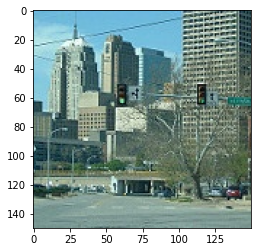

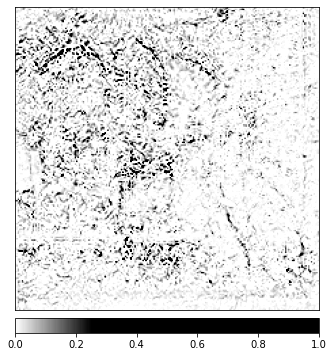

Predicted: buildings ( 0.9999058246612549 )


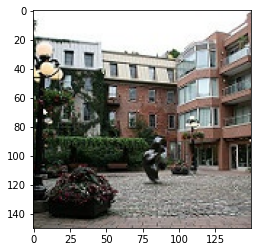

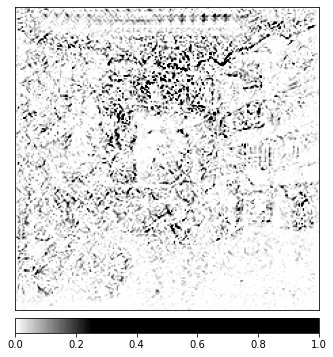

Predicted: forest ( 0.9998351335525513 )


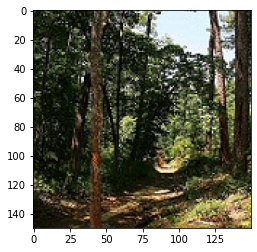

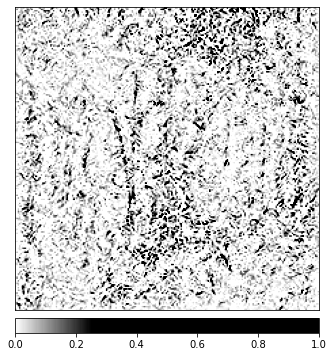

Predicted: forest ( 0.9999749660491943 )


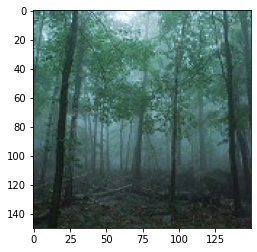

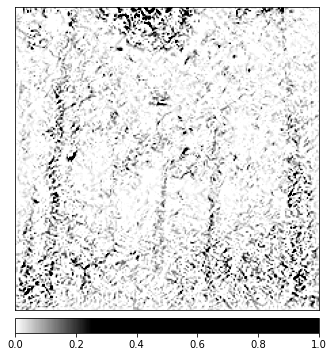

Predicted: glacier ( 1.0 )


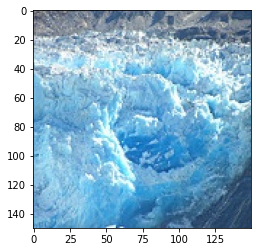

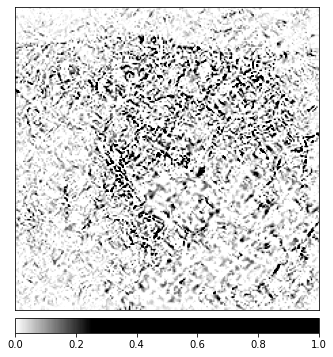

Predicted: glacier ( 0.9999996423721313 )


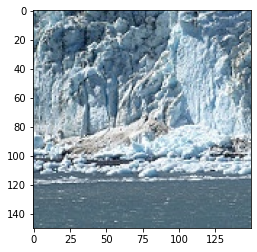

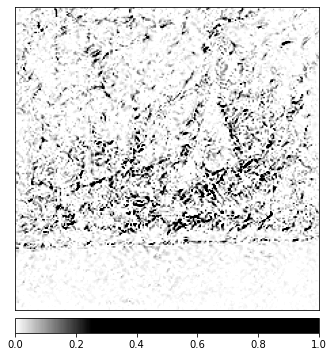

Predicted: mountain ( 0.9985948204994202 )


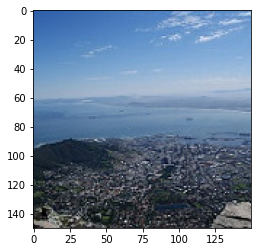

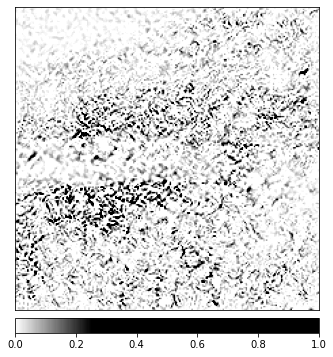

Predicted: mountain ( 0.999751627445221 )


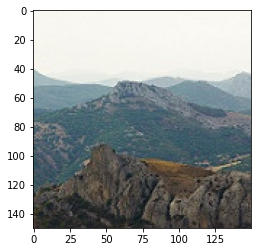

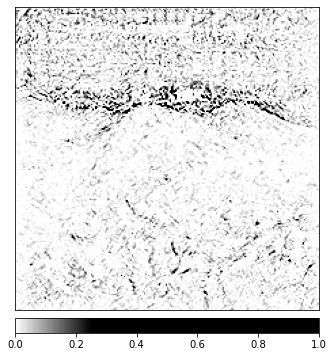

Predicted: sea ( 0.9980487823486328 )


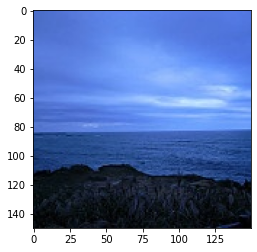

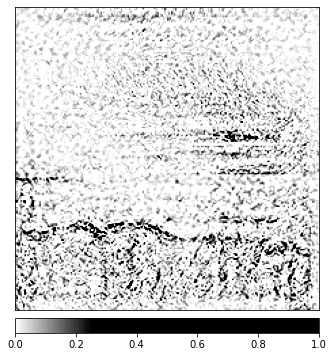

Predicted: sea ( 0.9999903440475464 )


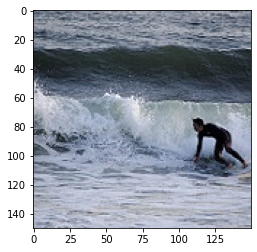

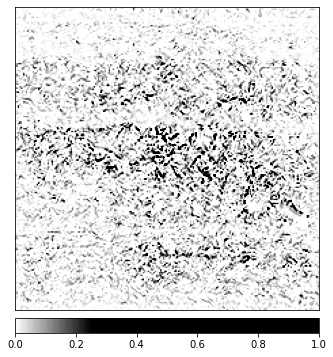

Predicted: street ( 0.9996788501739502 )


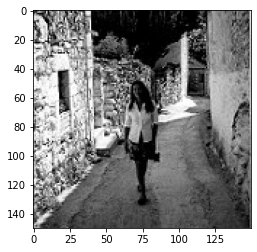

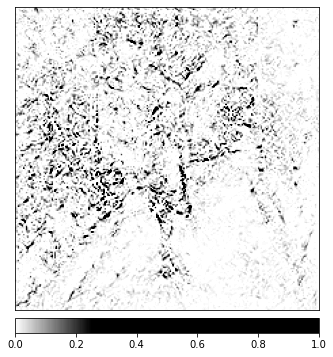

Predicted: street ( 0.9999977350234985 )


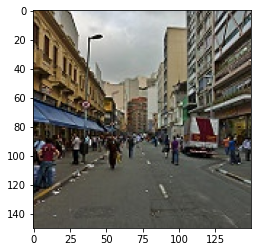

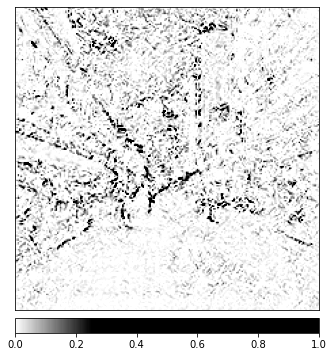

In [13]:
for image in images:
    img_tensor = transform(image)
    #img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor = img_tensor.to(device)
    output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)
    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]
    print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

    integrated_gradients = IntegratedGradients(model)
    attributions_ig = integrated_gradients.attribute(img_tensor, target=pred_label_idx, n_steps=200)
    
    default_cmap = LinearSegmentedColormap.from_list('custom blue', 
                                                 [(0, '#ffffff'),
                                                  (0.25, '#000000'),
                                                  (1, '#000000')], N=256)
    plt.imshow(image)

    _ = viz.visualize_image_attr(np.transpose(attributions_ig.squeeze().cpu().detach().numpy(), (1,2,0)),
                                 np.transpose(img_tensor.squeeze().cpu().detach().numpy(), (1,2,0)),
                                 method='heat_map',
                                 cmap=default_cmap,
                                 show_colorbar=True,
                                 sign='positive',
                                 outlier_perc=1)

# Integrated gradients with Noise Tunnel

Predicted: buildings ( 0.9998030066490173 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


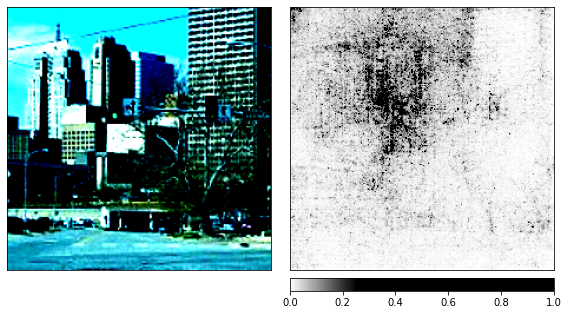

Predicted: buildings ( 0.9999058246612549 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


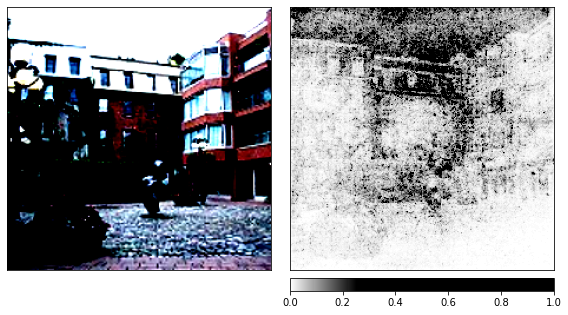

Predicted: forest ( 0.9998351335525513 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


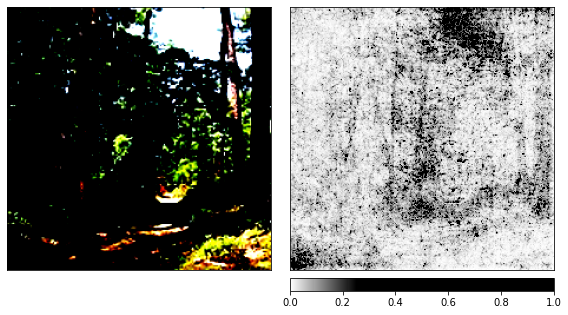

Predicted: forest ( 0.9999749660491943 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


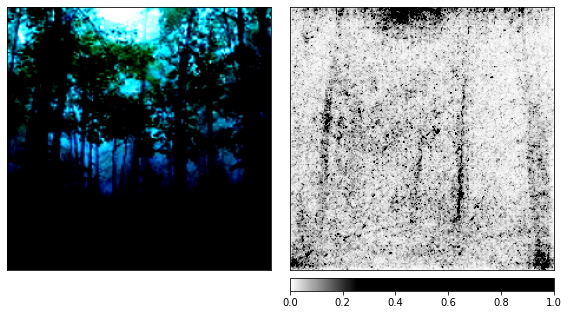

Predicted: glacier ( 1.0 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


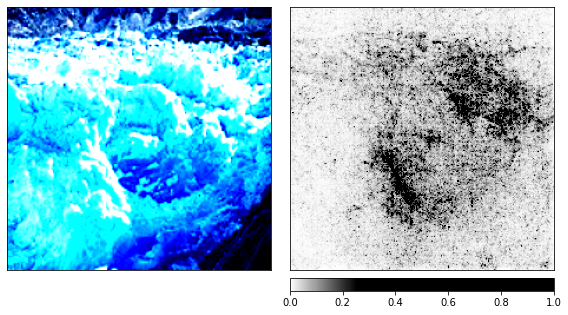

Predicted: glacier ( 0.9999996423721313 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


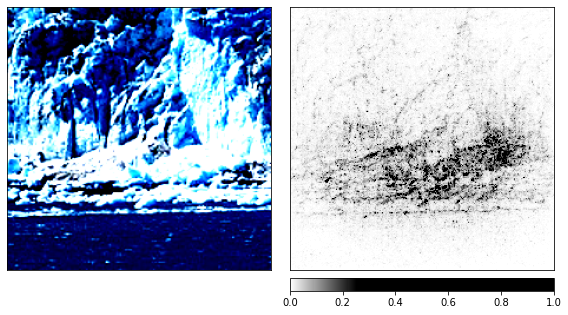

Predicted: mountain ( 0.9985948204994202 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


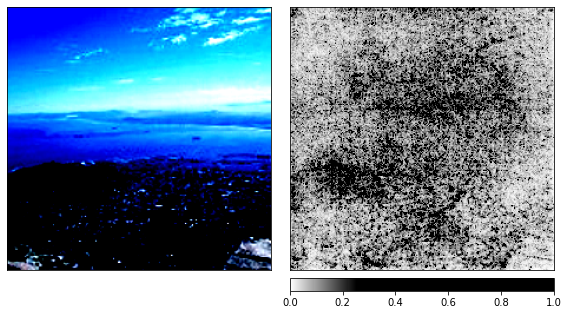

Predicted: mountain ( 0.999751627445221 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


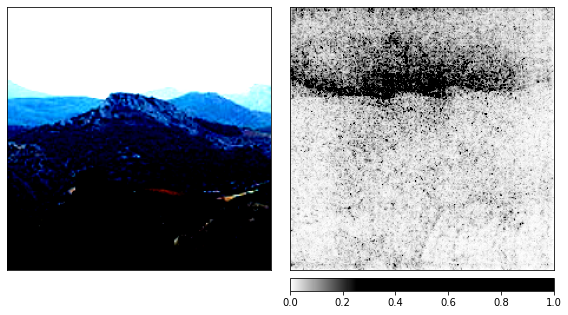

Predicted: sea ( 0.9980487823486328 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


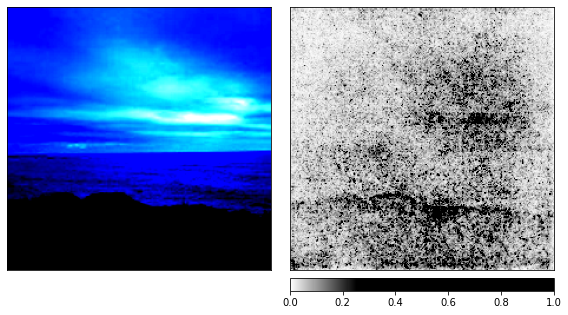

Predicted: sea ( 0.9999903440475464 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


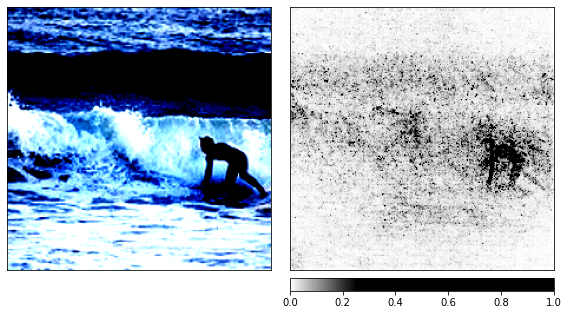

Predicted: street ( 0.9996788501739502 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


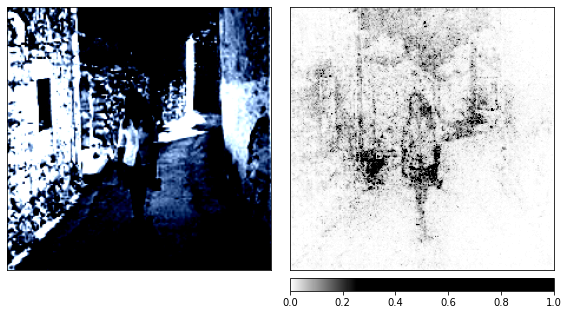

Predicted: street ( 0.9999977350234985 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


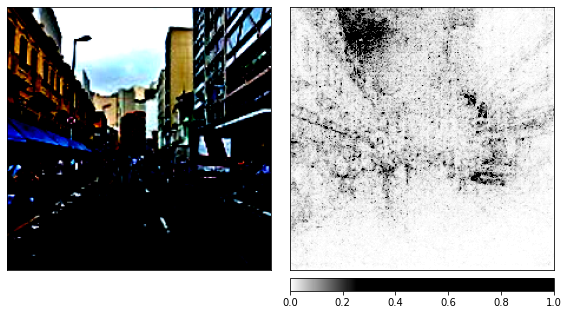

In [15]:
for image in images:
    img_tensor = transform(image)

    #img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)

    img_tensor = img_tensor.to(device)
    output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]
    print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

    integrated_gradients = IntegratedGradients(model)    
    noise_tunnel = NoiseTunnel(integrated_gradients)

    attributions_ig_nt = noise_tunnel.attribute(img_tensor, nt_samples=10, nt_type='smoothgrad_sq', target=pred_label_idx)
    _ = viz.visualize_image_attr_multiple(np.transpose(attributions_ig_nt.squeeze().cpu().detach().numpy(), (1,2,0)),
                                          np.transpose(img_tensor.squeeze().cpu().detach().numpy(), (1,2,0)),
                                          ["original_image", "heat_map"],
                                          ["all", "positive"],
                                          cmap=default_cmap,
                                          show_colorbar=True)

# Saliency

In [16]:
def attribute_image_features(algorithm, target1,input, **kwargs):
    model.zero_grad()
    tensor_attributions = algorithm.attribute(input,
                                              target=target1,
                                              **kwargs
                                             )
    
    return tensor_attributions

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


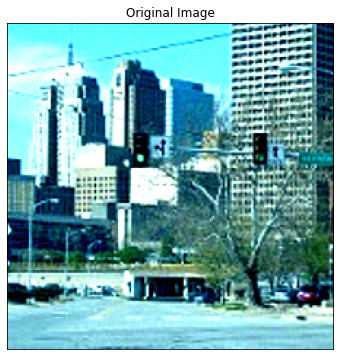

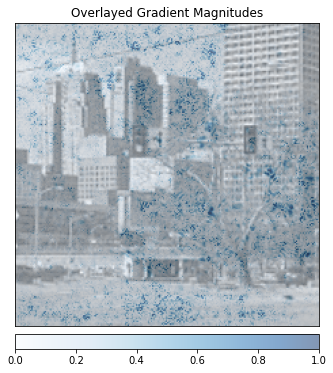

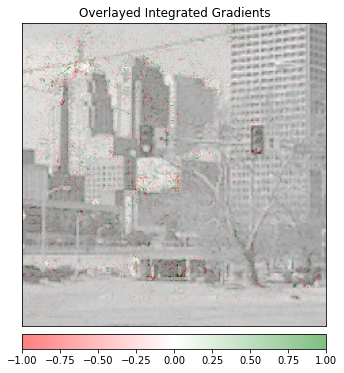

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


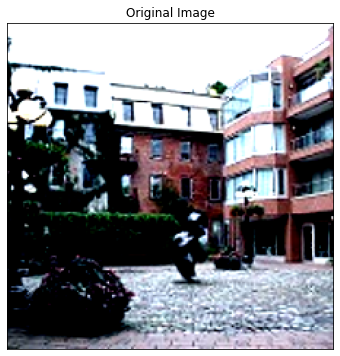

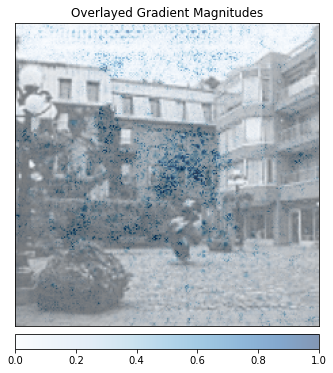

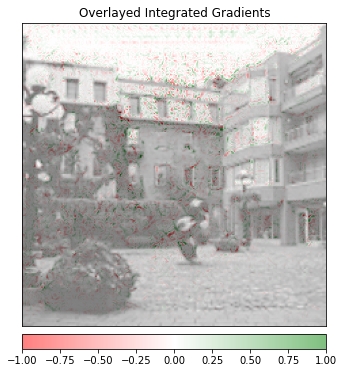

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


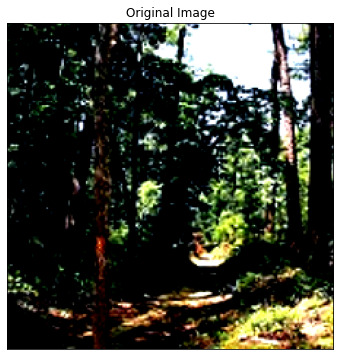

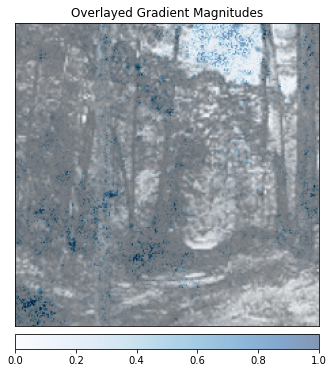

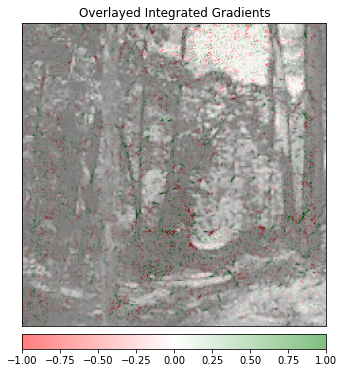

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


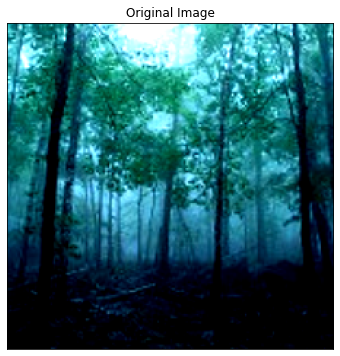

/home/jupyter-vit_abhinav/.local/lib/python3.9/site-packages/captum/attr/_utils/visualization.py:44: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that attribution values are allclose to 0.
  warnings.warn(


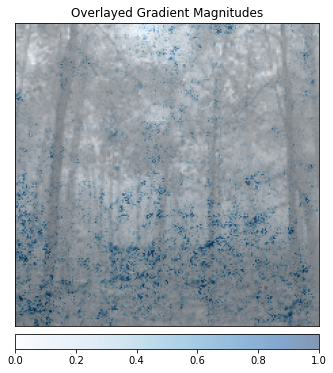

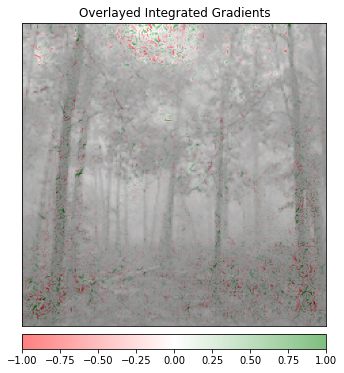

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


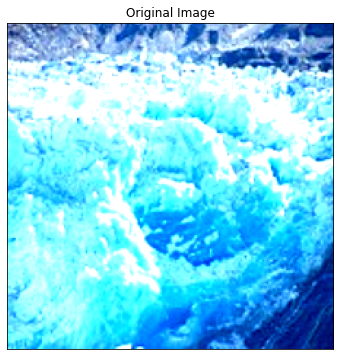

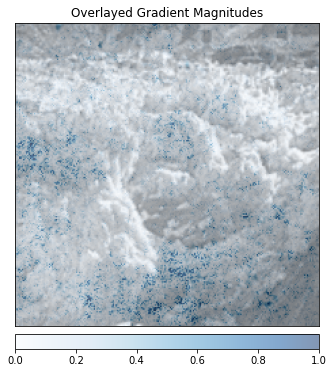

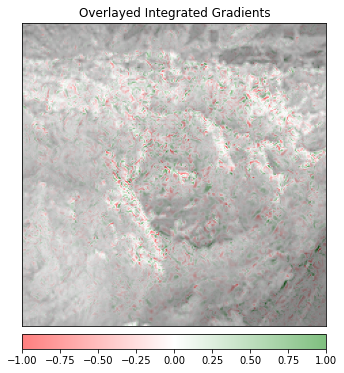

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


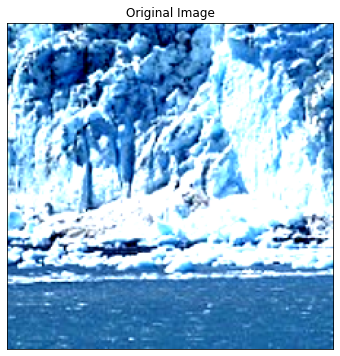

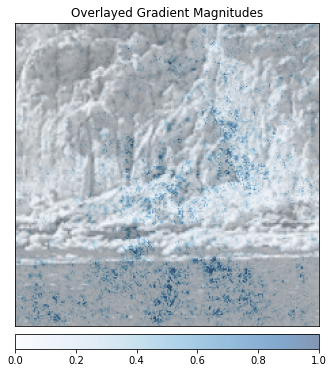

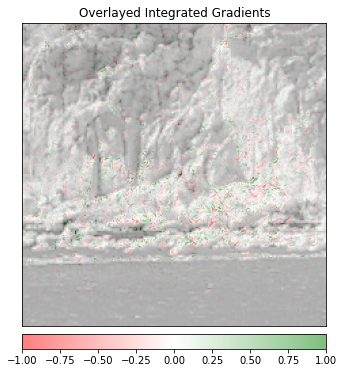

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


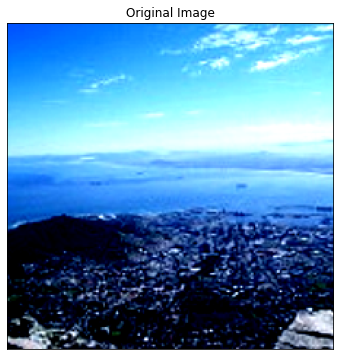

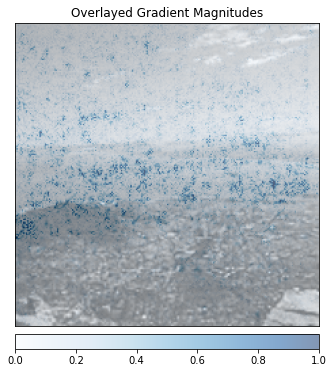

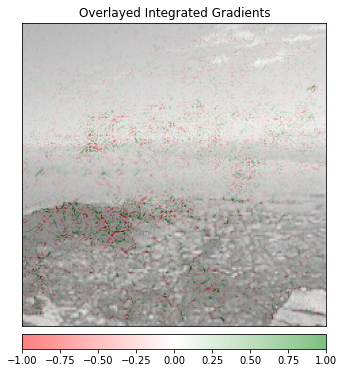

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


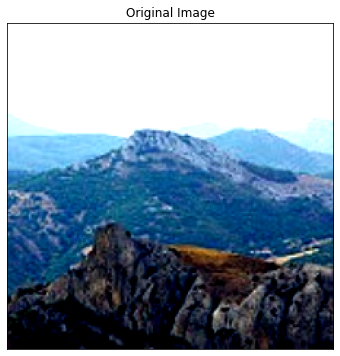

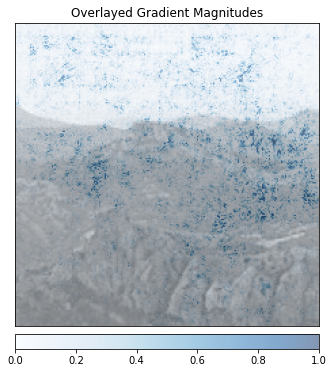

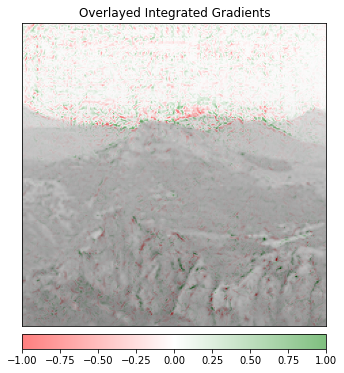

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


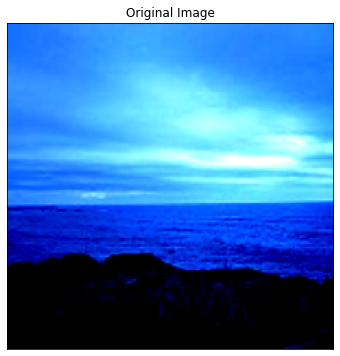

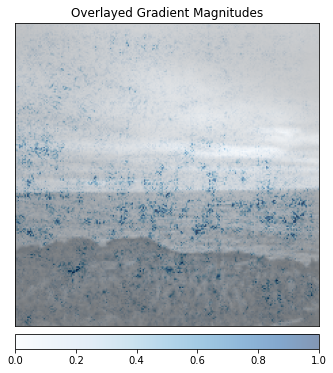

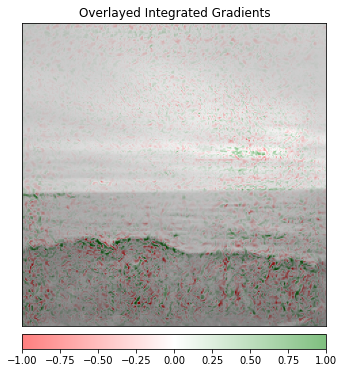

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


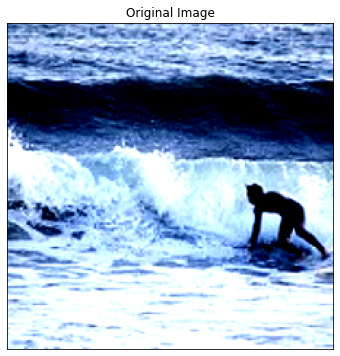

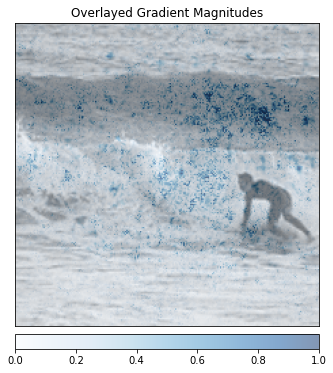

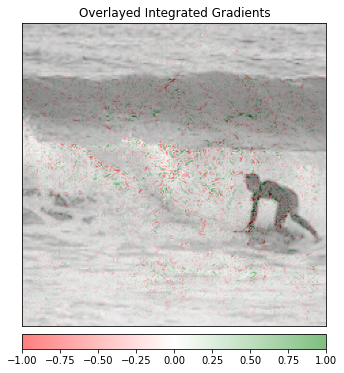

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


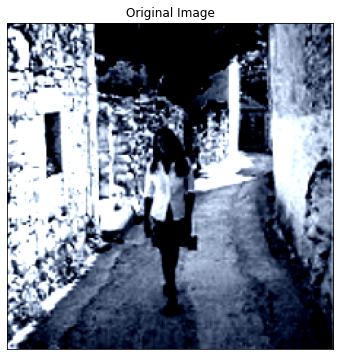

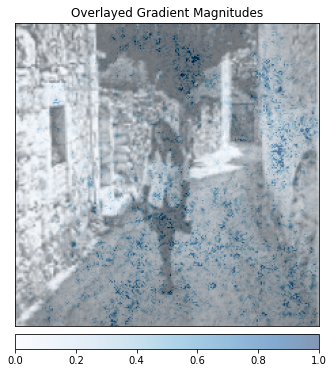

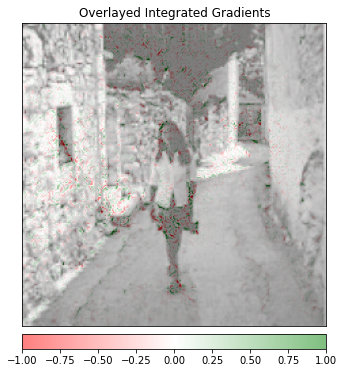

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


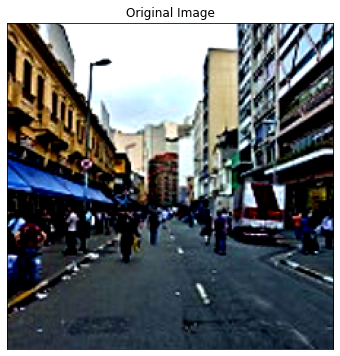

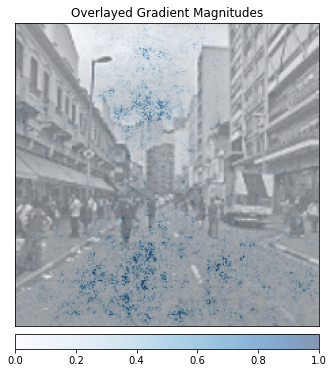

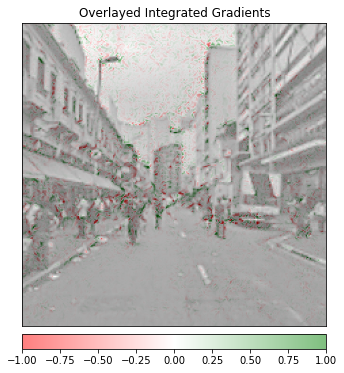

In [17]:
for i in range(len(images)):
    transform = T.Compose([ T.Resize((224, 224)),
                        T.ToTensor(),
                        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

    #img = Image.open('cat.jpeg')

    img_tensor = transform(images[i])
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor.requires_grad = True
    img_tensor = img_tensor.to(device)
    saliency = Saliency(model)
    grads = saliency.attribute(img_tensor, target=indexes[i])
    grads = np.transpose(grads.squeeze().cpu().detach().numpy(), (1, 2, 0))
    original_image = np.transpose((img_tensor.squeeze(0).cpu().detach().numpy() / 2) + 0.5, (1, 2, 0))
    _ = viz.visualize_image_attr(None, original_image, 
                      method="original_image", title="Original Image")
    _ = viz.visualize_image_attr(grads, original_image, method="blended_heat_map", sign="absolute_value",
                          show_colorbar=True, title="Overlayed Gradient Magnitudes")
    ig = IntegratedGradients(model)
    attr_ig, delta = attribute_image_features(ig, indexes[i],img_tensor, baselines=img_tensor * 0, return_convergence_delta=True)
    attr_ig = np.transpose(attr_ig.squeeze().cpu().detach().numpy(), (1, 2, 0))
    #print('Approximation delta: ', abs(delta))
    _ = viz.visualize_image_attr(attr_ig, original_image, method="blended_heat_map", sign="all",
                          show_colorbar=True, title="Overlayed Integrated Gradients")

# Occlusion

Predicted: buildings ( 0.9998030066490173 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


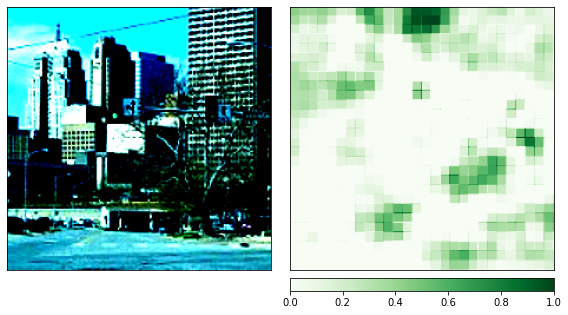

Predicted: buildings ( 0.9999058246612549 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


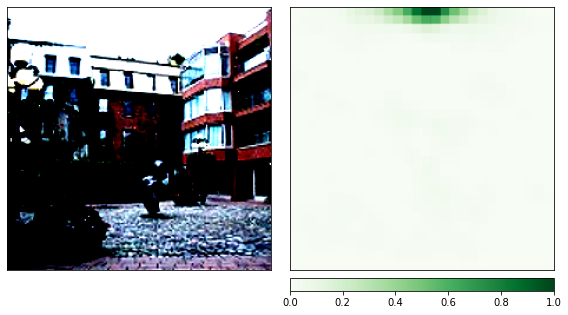

Predicted: forest ( 0.9998351335525513 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


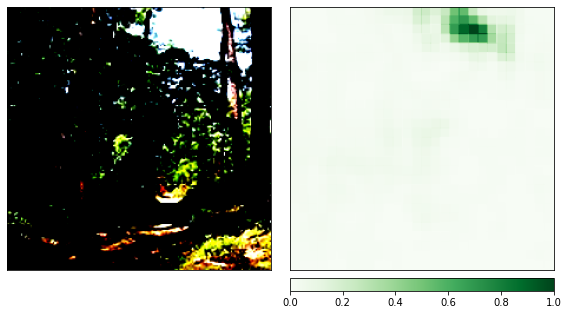

Predicted: forest ( 0.9999749660491943 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


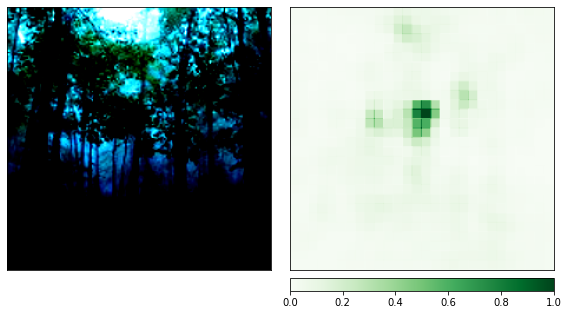

Predicted: glacier ( 1.0 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


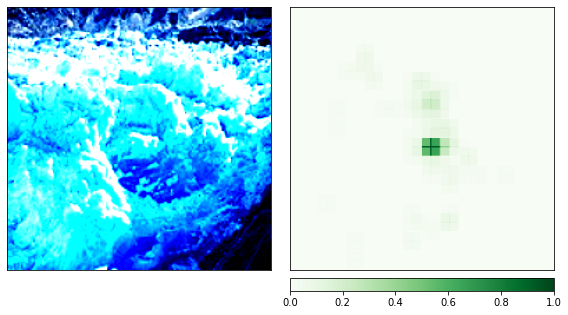

Predicted: glacier ( 0.9999996423721313 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


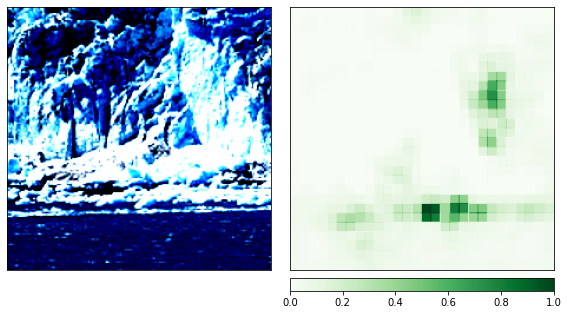

Predicted: mountain ( 0.9985948204994202 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


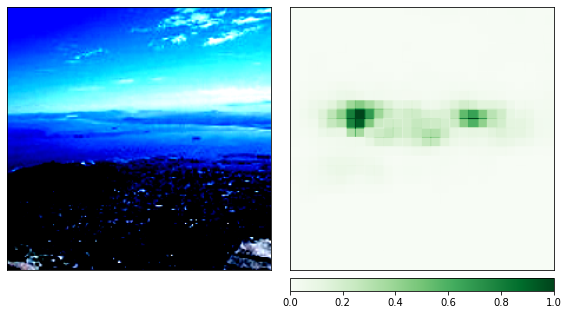

Predicted: mountain ( 0.999751627445221 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


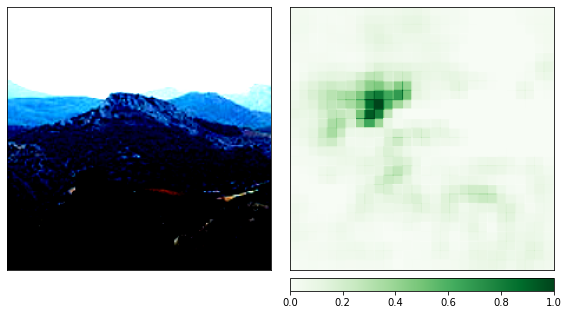

Predicted: sea ( 0.9980487823486328 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


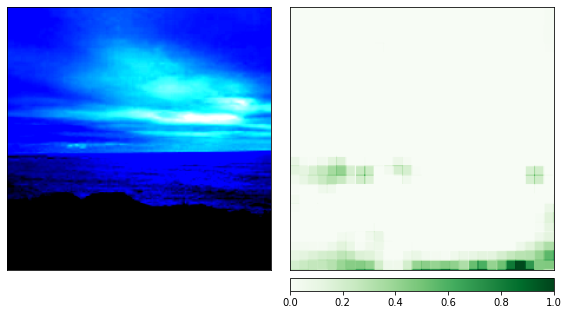

Predicted: sea ( 0.9999903440475464 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


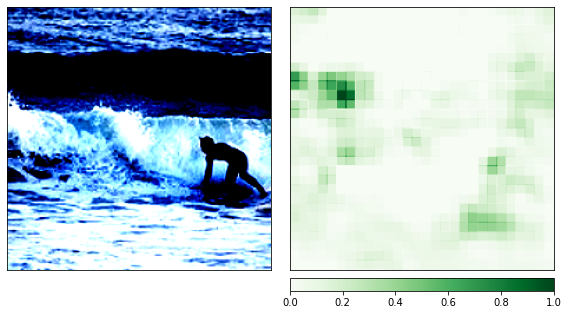

Predicted: street ( 0.9996788501739502 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


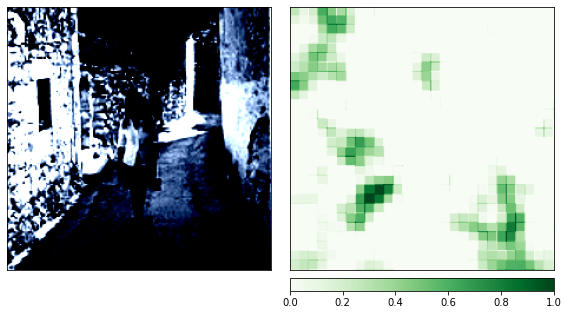

Predicted: street ( 0.9999977350234985 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


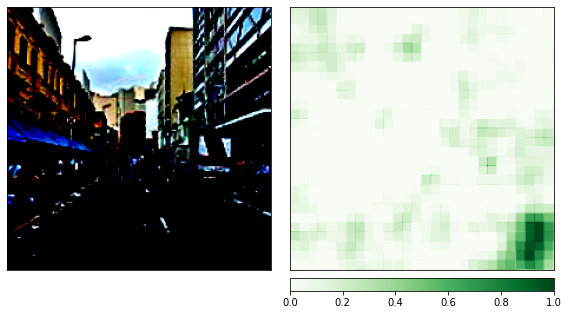

In [19]:
for image in images:
    img_tensor = transform(image)

    #img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)

    img_tensor = img_tensor.to(device)
    output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]
    print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

    integrated_gradients = IntegratedGradients(model)    
    occlusion = Occlusion(model)

    attributions_occ = occlusion.attribute(img_tensor,
                                           strides = (3, 8, 8),
                                           target=pred_label_idx,
                                           sliding_window_shapes=(3,15, 15),
                                           baselines=0)
    _ = viz.visualize_image_attr_multiple(np.transpose(attributions_occ.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(img_tensor.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      show_colorbar=True,
                                      outlier_perc=2,
                                     )

# Gradient SHAP

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: buildings ( 0.9998030066490173 )


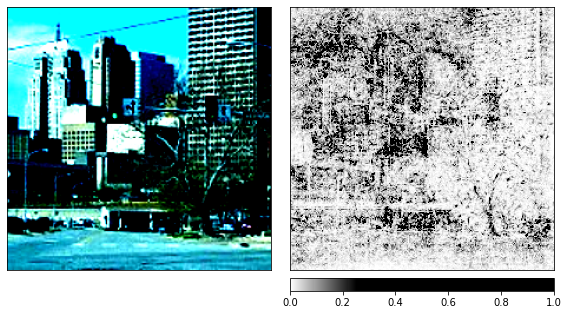

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: buildings ( 0.9999058246612549 )


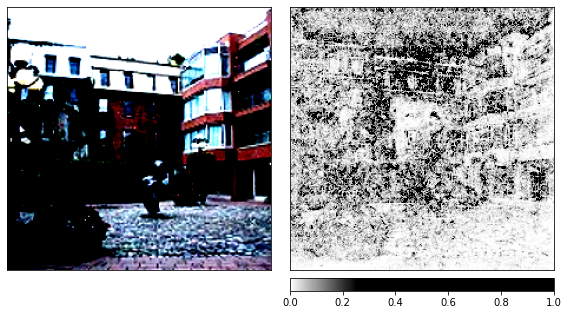

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: forest ( 0.9998351335525513 )


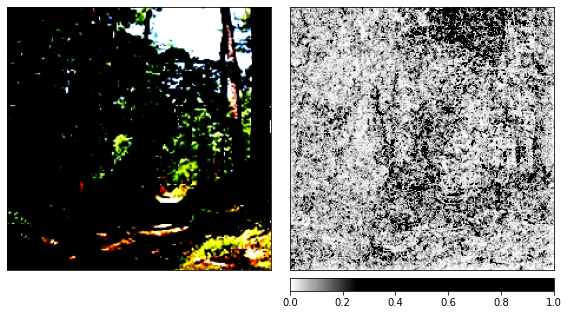

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: forest ( 0.9999749660491943 )


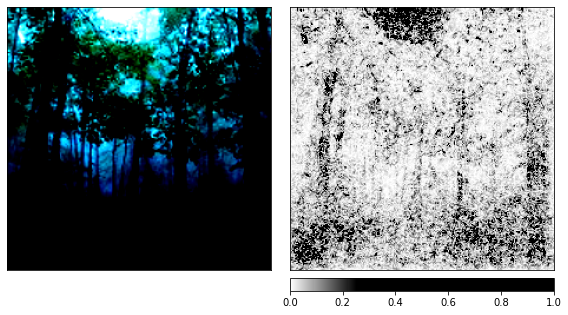

Predicted: glacier ( 1.0 )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


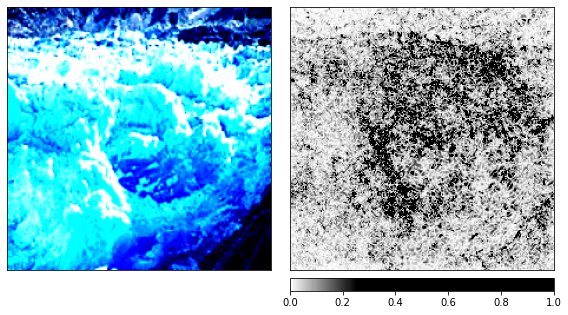

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: glacier ( 0.9999996423721313 )


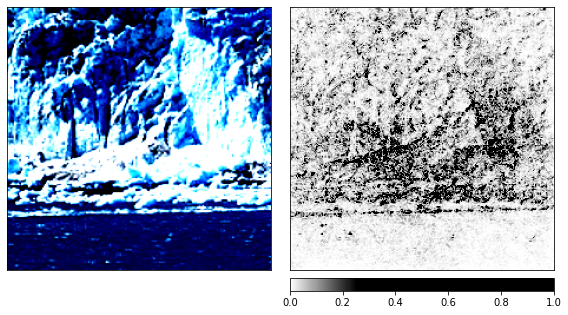

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: mountain ( 0.9985948204994202 )


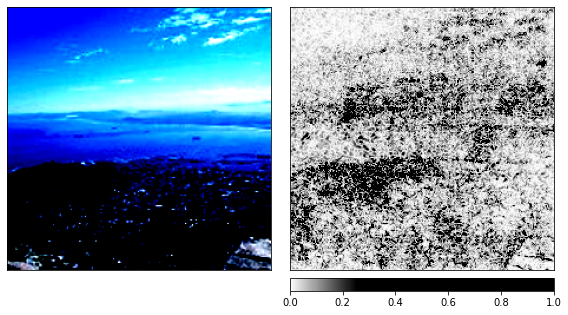

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: mountain ( 0.999751627445221 )


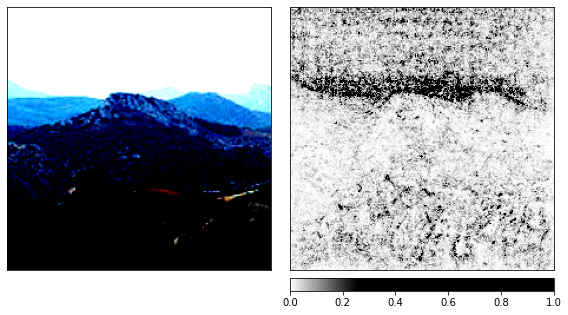

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: sea ( 0.9980487823486328 )


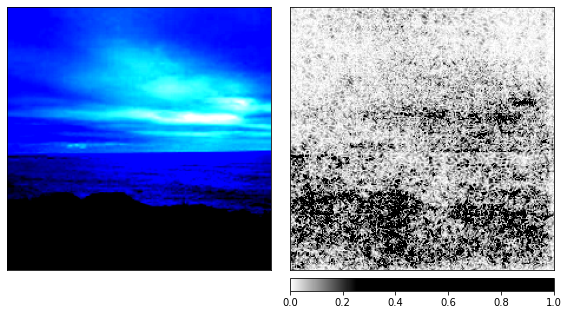

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: sea ( 0.9999903440475464 )


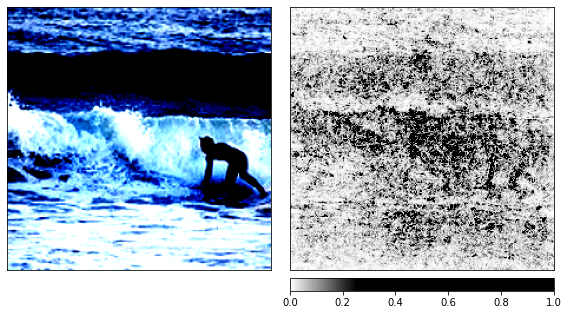

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: street ( 0.9996788501739502 )


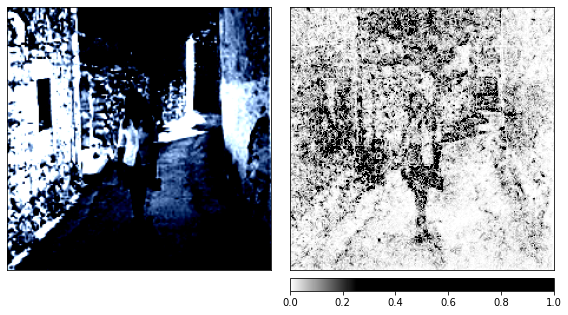

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted: street ( 0.9999977350234985 )


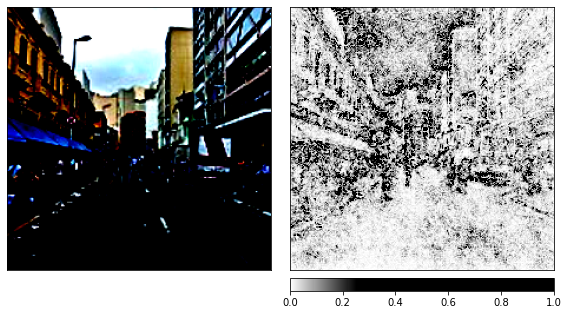

In [20]:
for image in images:
    img_tensor = transform(image)

    #img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)

    img_tensor = img_tensor.to(device)
    output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]
    print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

    integrated_gradients = IntegratedGradients(model)
    torch.manual_seed(0)
    np.random.seed(0)

    gradient_shap = GradientShap(model)

    # Defining baseline distribution of images
    rand_img_dist = torch.cat([img_tensor * 0, img_tensor * 1])

    attributions_gs = gradient_shap.attribute(img_tensor,
                                              n_samples=50,
                                              stdevs=0.0001,
                                              baselines=rand_img_dist,
                                              target=pred_label_idx)
    _ = viz.visualize_image_attr_multiple(np.transpose(attributions_gs.squeeze().cpu().detach().numpy(), (1,2,0)),
                                          np.transpose(img_tensor.squeeze().cpu().detach().numpy(), (1,2,0)),
                                          ["original_image", "heat_map"],
                                          ["all", "absolute_value"],
                                          cmap=default_cmap,
                                          show_colorbar=True)

In [21]:
import shap

In [22]:
def predict(imgs: torch.Tensor) -> torch.Tensor:
    imgs = torch.tensor(imgs)
    imgs = imgs.permute(0, 3, 1, 2)
    
    img_tensor = imgs.to(device)

    output = model(img_tensor)
    return output

Classes: [0]: ['buildings']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:27, 27.85s/it]               


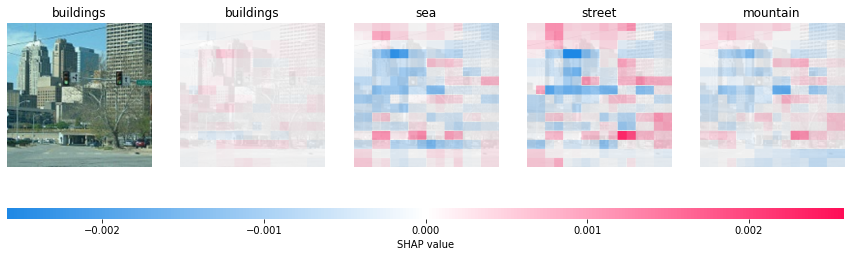

Classes: [0]: ['buildings']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.00s/it]               


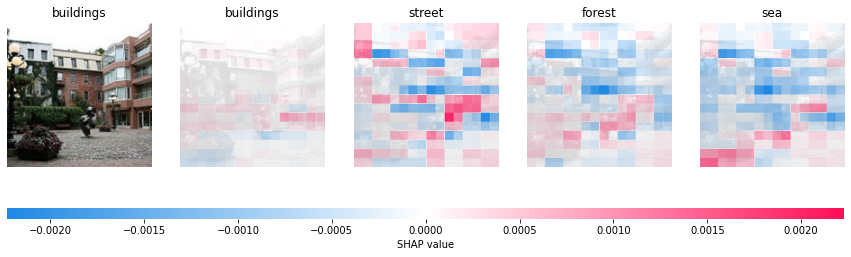

Classes: [1]: ['forest']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:24, 24.96s/it]               


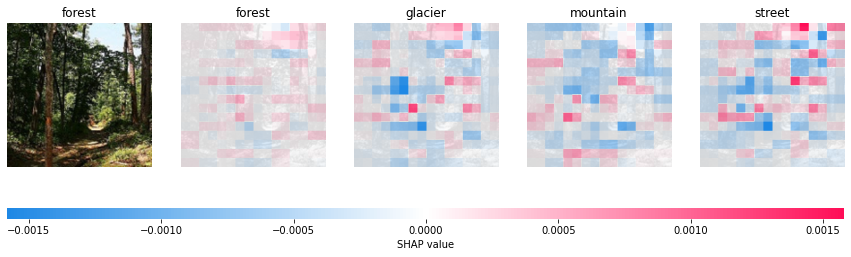

Classes: [1]: ['forest']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:24, 24.98s/it]               


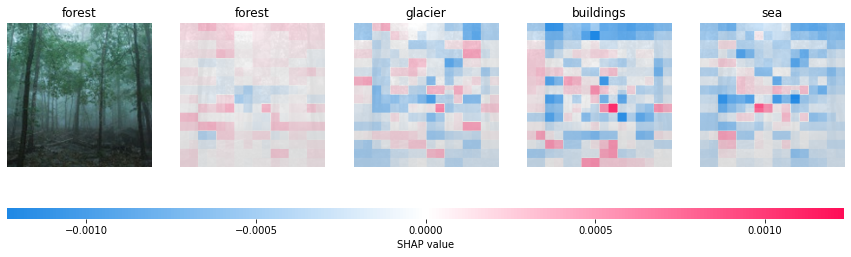

Classes: [2]: ['glacier']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:24, 24.84s/it]               


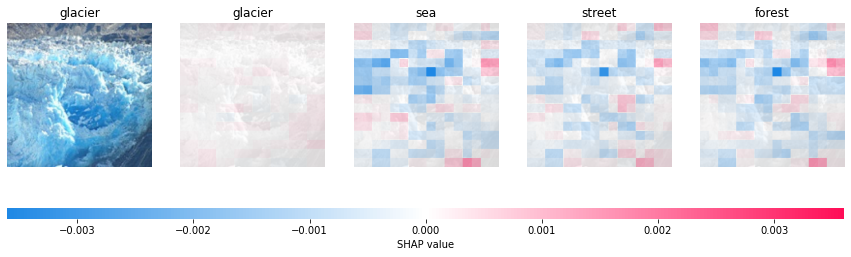

Classes: [2]: ['glacier']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:24, 24.55s/it]               


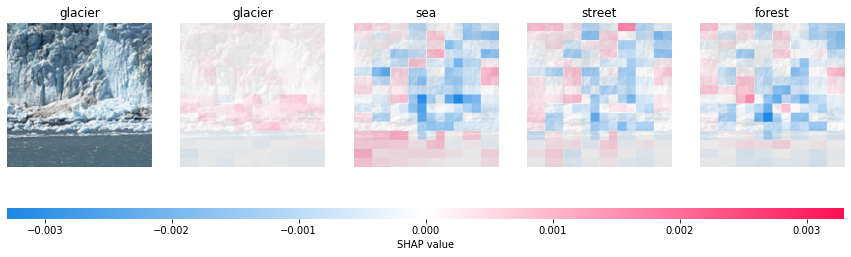

Classes: [3]: ['mountain']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.05s/it]               


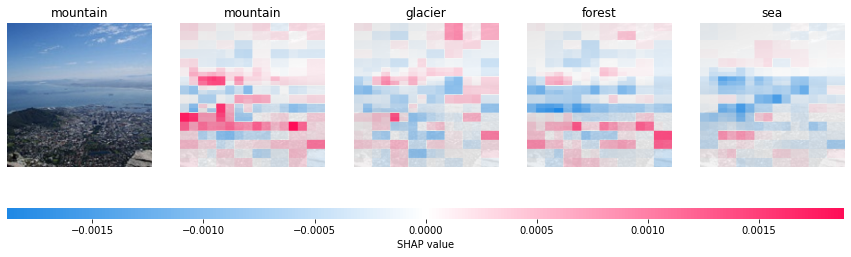

Classes: [3]: ['mountain']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:24, 24.83s/it]               


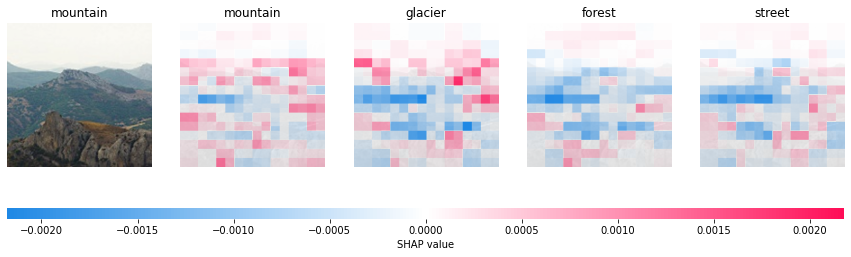

Classes: [4]: ['sea']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.18s/it]               


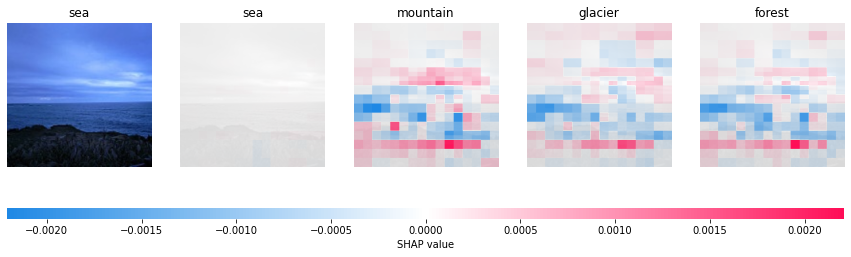

Classes: [4]: ['sea']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.66s/it]               


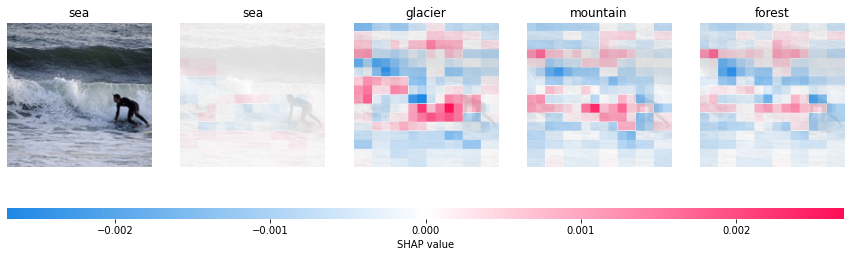

Classes: [5]: ['street']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.40s/it]               


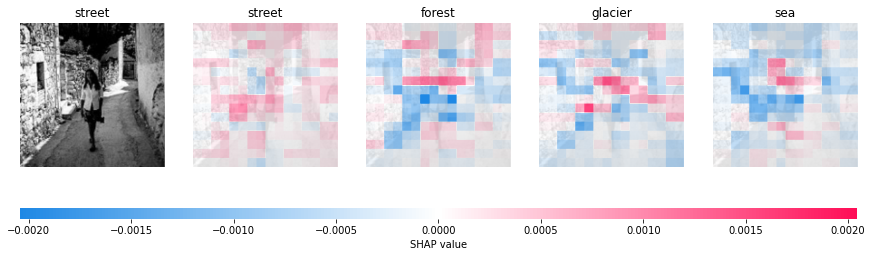

Classes: [5]: ['street']


  0%|          | 0/9998 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.37s/it]               


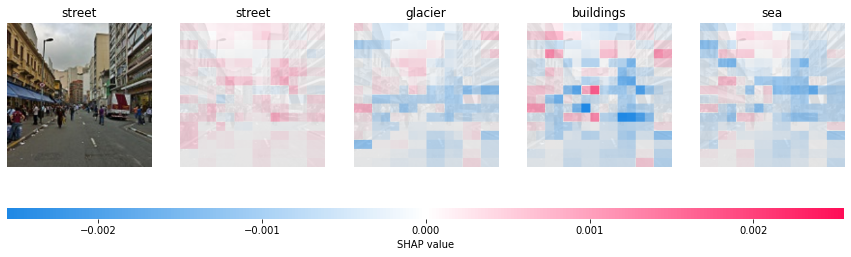

In [23]:
for i in range(len(images)):
    transform = T.Compose([ T.Resize((224, 224)),
                        T.ToTensor(),
                        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

    img_tensor = transform(images[i])
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor = img_tensor.to(device)
    model_out = model(img_tensor)
    classes = torch.argmax(model_out, axis=1).cpu().numpy()
    print(f'Classes: {classes}: {np.array(categories)[classes]}')
    mean = [0.485, 0.456, 0.406]
    std  = [0.229, 0.224, 0.225]
    inv_transform= T.Compose([
        T.Lambda(lambda x: x.permute(0, 3, 1, 2)),
        T.Normalize(
            mean = (-1 * np.array(mean) / np.array(std)).tolist(),
            std = (1 / np.array(std)).tolist()
        ),
        T.Lambda(lambda x: x.permute(0, 2, 3, 1)),
    ])
    
    topk = 4
    batch_size = 50
    n_evals = 10000

    # define a masker that is used to mask out partitions of the input image.
    masker_blur = shap.maskers.Image("blur(128,128)", (224, 224, 3))

    # create an explainer with model and image masker
    explainer = shap.Explainer(predict, masker_blur, output_names=categories)

    # feed only one image
    # here we explain two images using 100 evaluations of the underlying model to estimate the SHAP values
    #image_np = Image.open("cat.jpeg")
    img_tensor = transform(images[i])
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor = img_tensor.permute(0, 2, 3, 1)

    shap_values = explainer(img_tensor, max_evals=n_evals, batch_size=batch_size,
                            outputs=shap.Explanation.argsort.flip[:topk])
    shap_values.data = inv_transform(shap_values.data).cpu().numpy()[0]
    shap_values.values = [val for val in np.moveaxis(shap_values.values[0], -1, 0)]
    shap.image_plot(shap_values=shap_values.values,
                pixel_values=shap_values.data,
                labels=shap_values.output_names,
                true_labels=[categories[indexes[i]]])

In [34]:
#FGSM and PGD

In [35]:
from captum.robust import FGSM
from captum.robust import PGD

In [36]:
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]
inv_transform= T.Compose([
    T.Normalize(
        mean = (-1 * np.array(mean) / np.array(std)).tolist(),
        std = (1 / np.array(std)).tolist()
    ),
])

In [37]:
def get_prediction(model, image: torch.Tensor):
    model = model.to(device)
    img_tensor = image.to(device)
    with torch.no_grad():
        output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]

    return predicted_label, prediction_score.squeeze().item()

    # print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

In [38]:
def image_show(img, pred):
    npimg = inv_transform(img).squeeze().permute(1, 2, 0).detach().numpy()
    plt.imshow(npimg)
    plt.title("prediction: %s" % pred)
    plt.show()

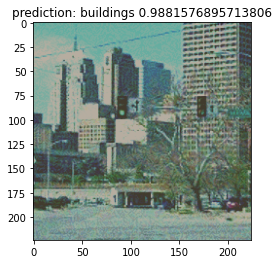

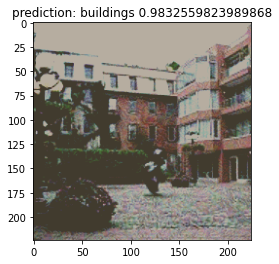

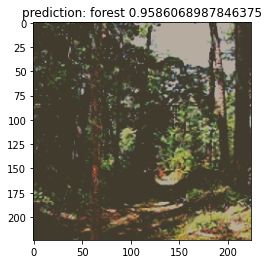

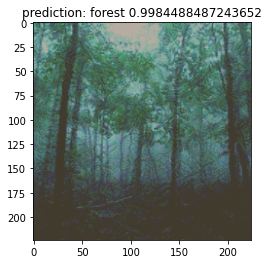

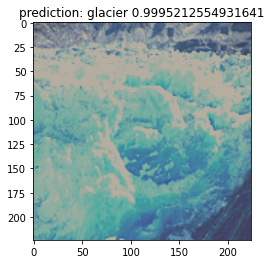

...

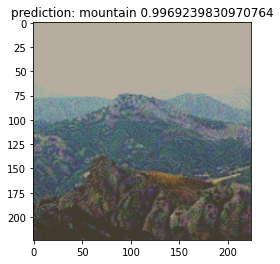

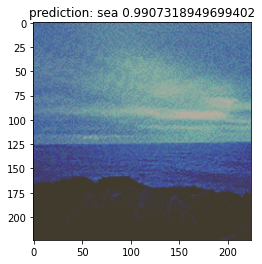

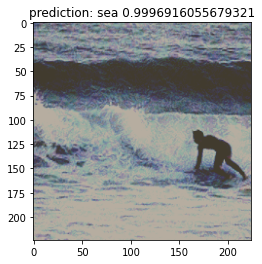

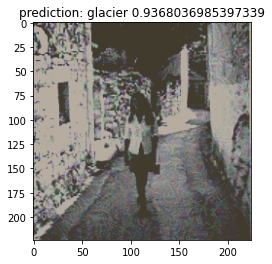

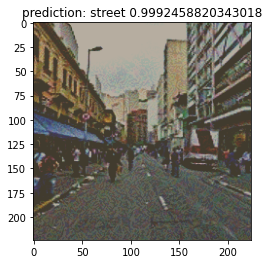

In [39]:
for i in range(len(images)):
    img_tensor = transform(images[i])
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor.requires_grad = True
    img_tensor = img_tensor.to(device)
    # Construct FGSM attacker
    fgsm = FGSM(model, lower_bound=-1, upper_bound=1)
    perturbed_image_fgsm = fgsm.perturb(img_tensor, epsilon=0.16, target=indexes[i]) 
    new_pred_fgsm, score_fgsm = get_prediction(model, perturbed_image_fgsm)
    image_show(perturbed_image_fgsm.cpu(), new_pred_fgsm + " " + str(score_fgsm))